In [19]:
import os
import sys
import cv2
import time
import math
import shutil
import random
import pickle
import argparse
import numpy as np
from glob import glob
import tensorflow as tf
import matplotlib.pyplot as plt
from tensorflow.keras import optimizers
from tensorflow.keras.layers import Dense
from tensorflow.keras.preprocessing import image
from tensorflow.keras.models import Sequential, load_model
from tensorflow.python.keras.callbacks import EarlyStopping, ModelCheckpoint
from tensorflow.keras.applications.resnet50 import preprocess_input, ResNet50
from tensorflow.keras.preprocessing.image import ImageDataGenerator, load_img, img_to_array, array_to_img
%matplotlib inline
sys.setrecursionlimit(1500)

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## IMPORT DATA IMAGES 

In [20]:
!mkdir dataset

In [21]:
%cd "/content/dataset/"
!mkdir validation
!mkdir train
!mkdir test

/content/dataset


In [22]:
dirs_x = ['validation', 'train']
dirs = ["no_human_found", "not_dense", "dense"]
for x in dirs_x:
  for y in dirs:
    os.mkdir(os.path.join(os.path.join(os.getcwd(), x), y))

In [23]:
for dirname, _, filenames in os.walk('/content/drive/MyDrive/basedata2/'):
    for filename in filenames:
        f_name = os.path.join(dirname, filename)
        new_file_name = f_name.replace("/content/drive/MyDrive/basedata2/", "/content/dataset/")
        shutil.copy(f_name, new_file_name)

# TIME

In [24]:
class TimeHistory(tf.keras.callbacks.Callback):
    def on_train_begin(self, logs={}):
        self.times = []

    def on_epoch_begin(self, epoch, logs={}):
        self.epoch_time_start = time.time()

    def on_epoch_end(self, epoch, logs={}):
        self.times.append(time.time() - self.epoch_time_start)


## Data Generators

In [25]:
def data_generator(image_size = 224, training_batch = 8, validation_batch = 4):
  train_data_generator = ImageDataGenerator(      #338 images in training for 3 classes , 90 images in validation for 3 classes
          preprocessing_function=preprocess_input,
          rotation_range=20,
          width_shift_range=0.2,   
          height_shift_range=0.2,
          horizontal_flip=True
      )
  valid_data_generator = ImageDataGenerator(preprocessing_function=preprocess_input)
  train_generator = train_data_generator.flow_from_directory(
          '/content/drive/MyDrive/basedata2/train/',
          target_size=(image_size, image_size),
          batch_size=training_batch,
          class_mode='categorical')

  validation_generator = valid_data_generator.flow_from_directory(
          '/content/drive/MyDrive/basedata2/validation',
          target_size=(image_size, image_size),
          batch_size=validation_batch,
          class_mode='categorical') 
  
  return train_generator, validation_generator

## Resnet50 Model

In [26]:
#intial 
def ResNet50Model(classes = 3, image_size = 224):
  model = Sequential() #keras layer in sequential order
  model.add(ResNet50(include_top = False, pooling = 'avg', weights = 'imagenet'))
  model.add(Dense(classes, activation = 'softmax'))
  model.layers[0].trainable = False

  model.compile(optimizer = 'sgd', loss = 'categorical_crossentropy', metrics = ['accuracy', tf.keras.metrics.AUC(from_logits=True), tf.keras.metrics.CategoricalAccuracy(), tf.keras.metrics.Precision(), tf.keras.metrics.Recall()])
  model.build(input_shape = (None, image_size, image_size, 3))
  model.summary()

  
  return model

In [27]:
def train_resnet50_model(epochs = 20):
  time_callback = TimeHistory()

  train_generator, validation_generator = data_generator()
  model = ResNet50Model()
  r = model.fit(
        train_generator,
        steps_per_epoch = 25,
        epochs = epochs,
        validation_data = validation_generator,
        validation_steps = 5,
        callbacks=[time_callback]
)
  
  r.history['time'] = time_callback.times

  model.save('resnet50.h5')
  pickle.dump(list(r.history.items()),open('resnet50_score.h5', 'wb'))

In [28]:
train_resnet50_model()

Found 358 images belonging to 3 classes.
Found 90 images belonging to 3 classes.
Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet50 (Functional)       (None, 2048)              23587712  
                                                                 
 dense_13 (Dense)            (None, 3)                 6147      
                                                                 
Total params: 23,593,859
Trainable params: 6,147
Non-trainable params: 23,587,712
_________________________________________________________________
Epoch 1/20
25/25 [==============================] - 26s 911ms/step - loss: 1.2726 - accuracy: 0.6616 - auc_4: 0.8125 - categorical_accuracy: 0.6616 - precision_4: 0.6649 - recall_4: 0.6212 - val_loss: 1.0844 - val_accuracy: 0.5500 - val_auc_4: 0.8600 - val_categorical_accuracy: 0.5500 - val_precision_4: 0.5500 - val_recall_4: 0.5500
Epoch 2/20
25/25 [

## TEST ResNet50

In [29]:
%cd "/content/dataset/test"
!mkdir "/content/dataset/test/new_test"

for x in os.listdir("/content/dataset/test"):
  shutil.move(os.path.join("/content/dataset/test", x), "/content/dataset/test/new_test")

/content/dataset/test


In [30]:
test_dir = '/content/dataset/test'
test_data_generator = ImageDataGenerator(preprocessing_function=preprocess_input)
test_generator = test_data_generator.flow_from_directory(
    directory = test_dir,
    target_size = (224, 224),
    batch_size = 4,
    class_mode = None,
    shuffle = False,
    seed = 42
)

Found 162 images belonging to 1 classes.


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: UserWarning: `Model.predict_generator` is deprecated and will be removed in a future version. Please use `Model.predict`, which supports generators.
  after removing the cwd from sys.path.


41/41 [==============================] - 12s 278ms/step


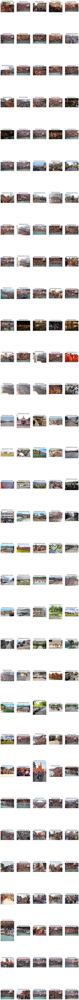

In [31]:
# test_dir +'/' +test_generator.filenames[i]
classes = ['Dense', 'No Human', "Not Dense"]
model = load_model("/content/drive/MyDrive/basedata2/resnet50.h5")
pred = model.predict_generator(test_generator, steps = len(test_generator), verbose = 1)
predicted_class_indices = np.argmax(pred, axis = 1)

f, ax = plt.subplots(32, 5, figsize = (15, 200))

for i in range(0,160):
    imgBGR = cv2.imread(test_dir + '/'+test_generator.filenames[i])
    imgRGB = cv2.cvtColor(imgBGR, cv2.COLOR_BGR2RGB)
    
    # a if condition else b
    predicted_class = classes[predicted_class_indices[i]]

    ax[i//5, i%5].imshow(imgRGB)
    ax[i//5, i%5].axis('off')
    ax[i//5, i%5].set_title("Predicted:{}".format(predicted_class))    

plt.show()

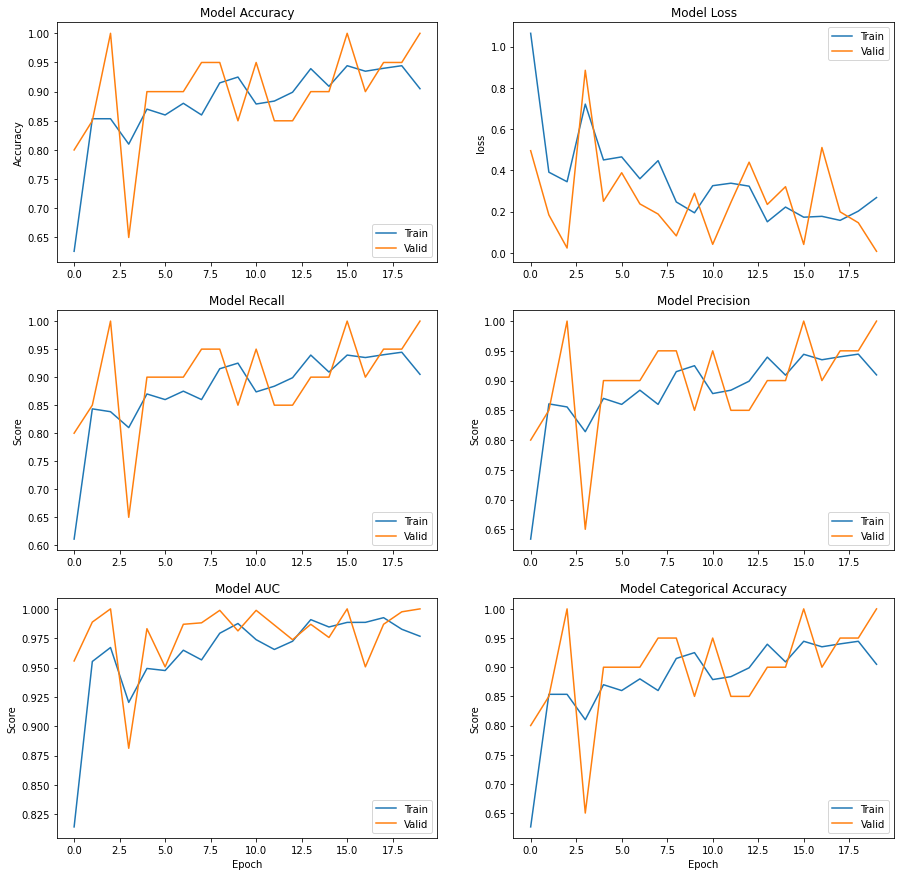

In [32]:
with open('/content/drive/MyDrive/basedata2/resnet50_score.h5', 'rb') as score:
    fit_history = pickle.load(score)

plt.figure(1, figsize = (15,15)) 


plt.subplot(321)  
plt.plot(fit_history[1][1])  
plt.plot(fit_history[7][1])  
plt.title('Model Accuracy')  
plt.ylabel('Accuracy')
plt.legend(['Train', 'Valid']) 
    
plt.subplot(322)  
plt.plot(fit_history[0][1])  
plt.plot(fit_history[6][1])  
plt.title('Model Loss')  
plt.ylabel('loss')  
plt.legend(['Train', 'Valid'])  

plt.subplot(323)  
plt.plot(fit_history[5][1])
plt.plot(fit_history[11][1])  
plt.title('Model Recall')  
plt.ylabel('Score')   
plt.legend(['Train', 'Valid']) 

plt.subplot(324)  
plt.plot(fit_history[4][1])
plt.plot(fit_history[10][1])  
plt.title('Model Precision')  
plt.ylabel('Score')  
plt.legend(['Train', 'Valid']) 

plt.subplot(325)  
plt.plot(fit_history[2][1])
plt.plot(fit_history[8][1])  
plt.title('Model AUC')  
plt.ylabel('Score')  
plt.xlabel('Epoch')   
plt.legend(['Train', 'Valid']) 

plt.subplot(326)  
plt.plot(fit_history[3][1])
plt.plot(fit_history[9][1])  
plt.title('Model Categorical Accuracy')  
plt.ylabel('Score')  
plt.xlabel('Epoch')   
plt.legend(['Train', 'Valid']) 

plt.show()

Found 358 images belonging to 3 classes.
Found 90 images belonging to 3 classes.


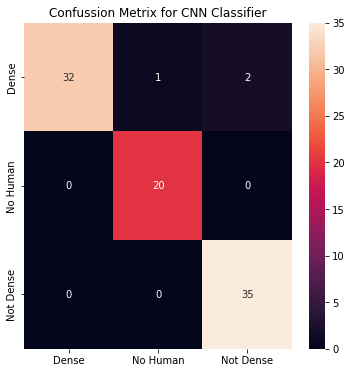

In [33]:
from sklearn.metrics import confusion_matrix
import seaborn as sn
import matplotlib.pyplot as plt
%matplotlib inline

classes = ['Dense', 'No Human', "Not Dense"]
_, valid_data = data_generator()
per = np.random.permutation(valid_data.n)
valid_data.index_array = per
cm = confusion_matrix(valid_data.classes[per], model.predict(valid_data).argmax(axis=1))
plt.figure(figsize = (6, 6))
plt.title("Confussion Metrix for CNN Classifier")
sn.heatmap(cm, annot=True, xticklabels=classes, yticklabels=classes)

In [34]:
from sklearn.metrics import classification_report
_, valid_data = data_generator()
per = np.random.permutation(valid_data.n)
valid_data.index_array = per
print(classification_report(valid_data.classes[per], model.predict(valid_data).argmax(axis=1), target_names=classes))

Found 358 images belonging to 3 classes.
Found 90 images belonging to 3 classes.
              precision    recall  f1-score   support

       Dense       1.00      0.91      0.96        35
    No Human       0.95      1.00      0.98        20
   Not Dense       0.95      1.00      0.97        35

    accuracy                           0.97        90
   macro avg       0.97      0.97      0.97        90
weighted avg       0.97      0.97      0.97        90



# VGG16

In [41]:
from tensorflow.keras.applications.vgg16 import preprocess_input, VGG16
def VGG16Model(classes = 3, image_size = 224):
  model = Sequential()
  model.add(VGG16(include_top = False, pooling = 'avg', weights = 'imagenet'))
  model.add(Dense(classes, activation = 'softmax'))
  model.layers[0].trainable = False

  model.compile(optimizer = 'sgd', loss = 'categorical_crossentropy', metrics = ['accuracy', tf.keras.metrics.AUC(from_logits=True), tf.keras.metrics.CategoricalAccuracy(), tf.keras.metrics.Precision(), tf.keras.metrics.Recall()])
  model.build(input_shape = (None, image_size, image_size, 3))
  model.summary()
  return model

In [42]:
def train_vgg16_model(epochs = 20):
  time_callback = TimeHistory()

  train_generator, validation_generator = data_generator()
  model = VGG16Model()
  r = model.fit(
        train_generator,
        steps_per_epoch = 25,
        epochs = epochs,
        validation_data = validation_generator,
        validation_steps = 5,
        callbacks=[time_callback]
)
  
  r.history['time'] = time_callback.times

  model.save('/content/drive/MyDrive/basedata2/vgg16.h5')
  pickle.dump(list(r.history.items()),open('/content/drive/MyDrive/basedata2/vgg16_score.h5', 'wb'))

In [43]:
train_vgg16_model()

Found 358 images belonging to 3 classes.
Found 90 images belonging to 3 classes.
Model: "sequential_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 vgg16 (Functional)          (None, 512)               14714688  
                                                                 
 dense_16 (Dense)            (None, 3)                 1539      
                                                                 
Total params: 14,716,227
Trainable params: 1,539
Non-trainable params: 14,714,688
_________________________________________________________________
Epoch 1/20
25/25 [==============================] - 25s 923ms/step - loss: 7.1550 - accuracy: 0.6650 - auc_7: 0.7654 - categorical_accuracy: 0.6650 - precision_7: 0.6650 - recall_7: 0.6650 - val_loss: 0.8236 - val_accuracy: 0.9000 - val_auc_7: 0.9575 - val_categorical_accuracy: 0.9000 - val_precision_7: 0.9000 - val_recall_7: 0.9000
Epoch 2/20
25/25 [

In [44]:
test_dir = '/content/dataset/test'
test_data_generator = ImageDataGenerator(preprocessing_function=preprocess_input)
test_generator = test_data_generator.flow_from_directory(
    directory = test_dir,
    target_size = (224, 224),
    batch_size = 4,
    class_mode = None,
    shuffle = False,
    seed = 42
)

Found 162 images belonging to 1 classes.


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: UserWarning: `Model.predict_generator` is deprecated and will be removed in a future version. Please use `Model.predict`, which supports generators.
  after removing the cwd from sys.path.


41/41 [==============================] - 12s 286ms/step


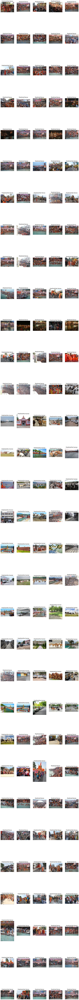

In [45]:
# test_dir +'/' +test_generator.filenames[i]
classes = ['Dense', 'No Human', "Not Dense"]
model = load_model("/content/drive/MyDrive/basedata2/vgg16.h5")
pred = model.predict_generator(test_generator, steps = len(test_generator), verbose = 1)
predicted_class_indices = np.argmax(pred, axis = 1)

f, ax = plt.subplots(32, 5, figsize = (15, 200))

for i in range(0,160):
    imgBGR = cv2.imread(test_dir + '/'+test_generator.filenames[i])
    imgRGB = cv2.cvtColor(imgBGR, cv2.COLOR_BGR2RGB)
    
    # a if condition else b
    predicted_class = classes[predicted_class_indices[i]]

    ax[i//5, i%5].imshow(imgRGB)
    ax[i//5, i%5].axis('off')
    ax[i//5, i%5].set_title("Predicted:{}".format(predicted_class))    

plt.show()

In [50]:
print(model)

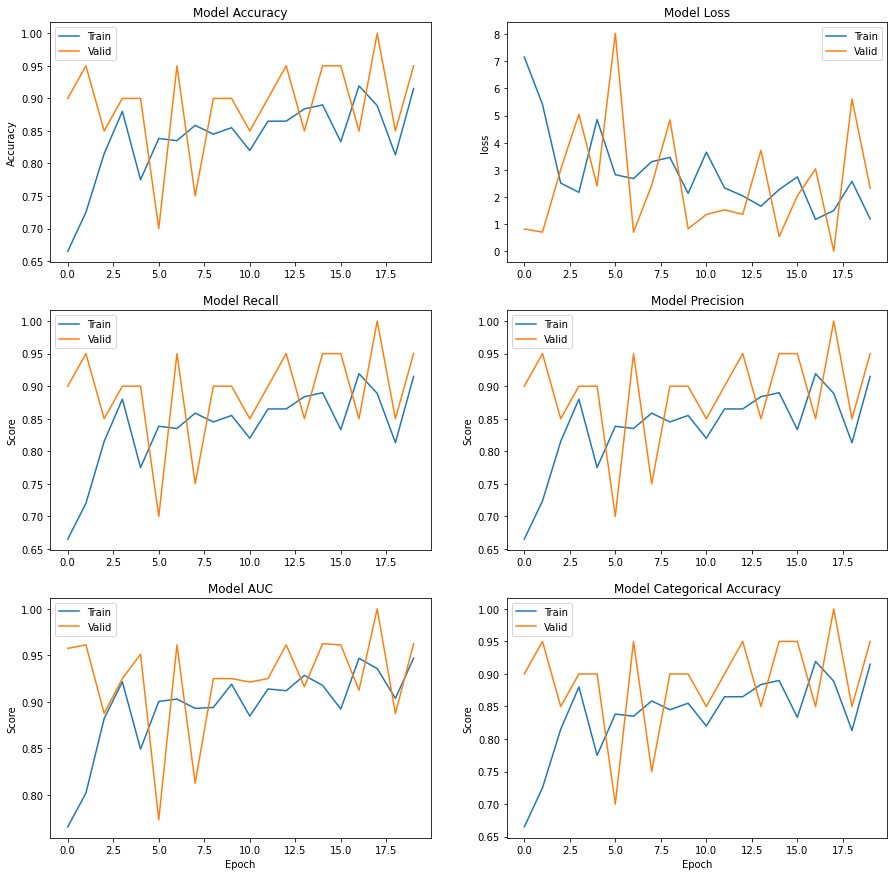

In [46]:
with open('/content/drive/MyDrive/basedata2/vgg16_score.h5', 'rb') as score:
    fit_history = pickle.load(score)

plt.figure(1, figsize = (15,15)) 


plt.subplot(321)  
plt.plot(fit_history[1][1])  
plt.plot(fit_history[7][1])  
plt.title('Model Accuracy')  
plt.ylabel('Accuracy')
plt.legend(['Train', 'Valid']) 
    
plt.subplot(322)  
plt.plot(fit_history[0][1])  
plt.plot(fit_history[6][1])  
plt.title('Model Loss')  
plt.ylabel('loss')  
plt.legend(['Train', 'Valid'])  

plt.subplot(323)  
plt.plot(fit_history[5][1])
plt.plot(fit_history[11][1])  
plt.title('Model Recall')  
plt.ylabel('Score')   
plt.legend(['Train', 'Valid']) 

plt.subplot(324)  
plt.plot(fit_history[4][1])
plt.plot(fit_history[10][1])  
plt.title('Model Precision')  
plt.ylabel('Score')  
plt.legend(['Train', 'Valid']) 

plt.subplot(325)  
plt.plot(fit_history[2][1])
plt.plot(fit_history[8][1])  
plt.title('Model AUC')  
plt.ylabel('Score')  
plt.xlabel('Epoch')   
plt.legend(['Train', 'Valid']) 

plt.subplot(326)  
plt.plot(fit_history[3][1])
plt.plot(fit_history[9][1])  
plt.title('Model Categorical Accuracy')  
plt.ylabel('Score')  
plt.xlabel('Epoch')   
plt.legend(['Train', 'Valid']) 

plt.show()

Found 358 images belonging to 3 classes.
Found 90 images belonging to 3 classes.


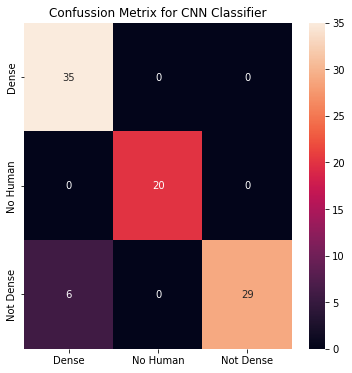

In [47]:
from sklearn.metrics import confusion_matrix
import seaborn as sn
import matplotlib.pyplot as plt
%matplotlib inline

classes = ['Dense', 'No Human', "Not Dense"]
_, valid_data = data_generator()
per = np.random.permutation(valid_data.n)
valid_data.index_array = per
cm = confusion_matrix(valid_data.classes[per], model.predict(valid_data).argmax(axis=1))
plt.figure(figsize = (6, 6))
plt.title("Confussion Metrix for CNN Classifier")
sn.heatmap(cm, annot=True, xticklabels=classes, yticklabels=classes)

In [48]:
from sklearn.metrics import classification_report
_, valid_data = data_generator()
per = np.random.permutation(valid_data.n)
valid_data.index_array = per
print(classification_report(valid_data.classes[per], model.predict(valid_data).argmax(axis=1), target_names=classes))

Found 358 images belonging to 3 classes.
Found 90 images belonging to 3 classes.
              precision    recall  f1-score   support

       Dense       0.85      1.00      0.92        35
    No Human       1.00      1.00      1.00        20
   Not Dense       1.00      0.83      0.91        35

    accuracy                           0.93        90
   macro avg       0.95      0.94      0.94        90
weighted avg       0.94      0.93      0.93        90



# MobileNet

In [51]:
from tensorflow.keras.applications.mobilenet import preprocess_input, MobileNet

def MobileNetModel(classes = 3, image_size = 224):
  model = Sequential()
  model.add(MobileNet(include_top = False, pooling = 'avg', weights = 'imagenet'))
  model.add(Dense(classes, activation = 'softmax'))
  model.layers[0].trainable = False

  model.compile(optimizer = 'sgd', loss = 'categorical_crossentropy', metrics = ['accuracy', tf.keras.metrics.AUC(from_logits=True), tf.keras.metrics.CategoricalAccuracy(), tf.keras.metrics.Precision(), tf.keras.metrics.Recall()])
  model.build(input_shape = (None, image_size, image_size, 3))
  model.summary()
  return model

In [52]:
def train_mobilenet_model(epochs = 20):
  time_callback = TimeHistory()

  train_generator, validation_generator = data_generator()
  model = MobileNetModel()
  r = model.fit(
        train_generator,
        steps_per_epoch = 25,
        epochs = epochs,
        validation_data = validation_generator,
        validation_steps = 5,
        callbacks=[time_callback]
)
  
  r.history['time'] = time_callback.times

  model.save('/content/drive/MyDrive/basedata2/mobilenet.h5')
  pickle.dump(list(r.history.items()),open('/content/drive/MyDrive/basedata2/mobilenet_score.h5', 'wb'))

In [53]:
train_mobilenet_model()

Found 358 images belonging to 3 classes.
Found 90 images belonging to 3 classes.
17235968/17225924 [==============================] - 0s 0us/step
Model: "sequential_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 mobilenet_1.00_224 (Functio  (None, 1024)             3228864   
 nal)                                                            
                                                                 
 dense_17 (Dense)            (None, 3)                 3075      
                                                                 
Total params: 3,231,939
Trainable params: 3,075
Non-trainable params: 3,228,864
_________________________________________________________________
Epoch 1/20
25/25 [==============================] - 24s 883ms/step - loss: 1.0707 - accuracy: 0.5606 - auc_8: 0.7527 - categorical_accuracy: 0.5606 - precision_8: 0.5674 - recall_8: 0.5101 - val_loss: 0.5624 - val_accuracy: 

In [54]:
test_dir = '/content/dataset/test'
test_data_generator = ImageDataGenerator(preprocessing_function=preprocess_input)
test_generator = test_data_generator.flow_from_directory(
    directory = test_dir,
    target_size = (224, 224),
    batch_size = 4,
    class_mode = None,
    shuffle = False,
    seed = 42
)

Found 162 images belonging to 1 classes.


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: UserWarning: `Model.predict_generator` is deprecated and will be removed in a future version. Please use `Model.predict`, which supports generators.
  after removing the cwd from sys.path.


41/41 [==============================] - 11s 257ms/step


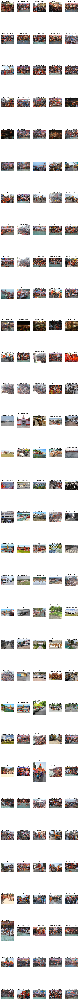

In [55]:
# test_dir +'/' +test_generator.filenames[i]
classes = ['Dense', 'No Human', "Not Dense"]
model = load_model("/content/drive/MyDrive/basedata2/mobilenet.h5")
pred = model.predict_generator(test_generator, steps = len(test_generator), verbose = 1)
predicted_class_indices = np.argmax(pred, axis = 1)

f, ax = plt.subplots(32, 5, figsize = (15, 200))

for i in range(0,160):
    imgBGR = cv2.imread(test_dir + '/'+test_generator.filenames[i])
    imgRGB = cv2.cvtColor(imgBGR, cv2.COLOR_BGR2RGB)
    
    # a if condition else b
    predicted_class = classes[predicted_class_indices[i]]

    ax[i//5, i%5].imshow(imgRGB)
    ax[i//5, i%5].axis('off')
    ax[i//5, i%5].set_title("Predicted:{}".format(predicted_class))    

plt.show()

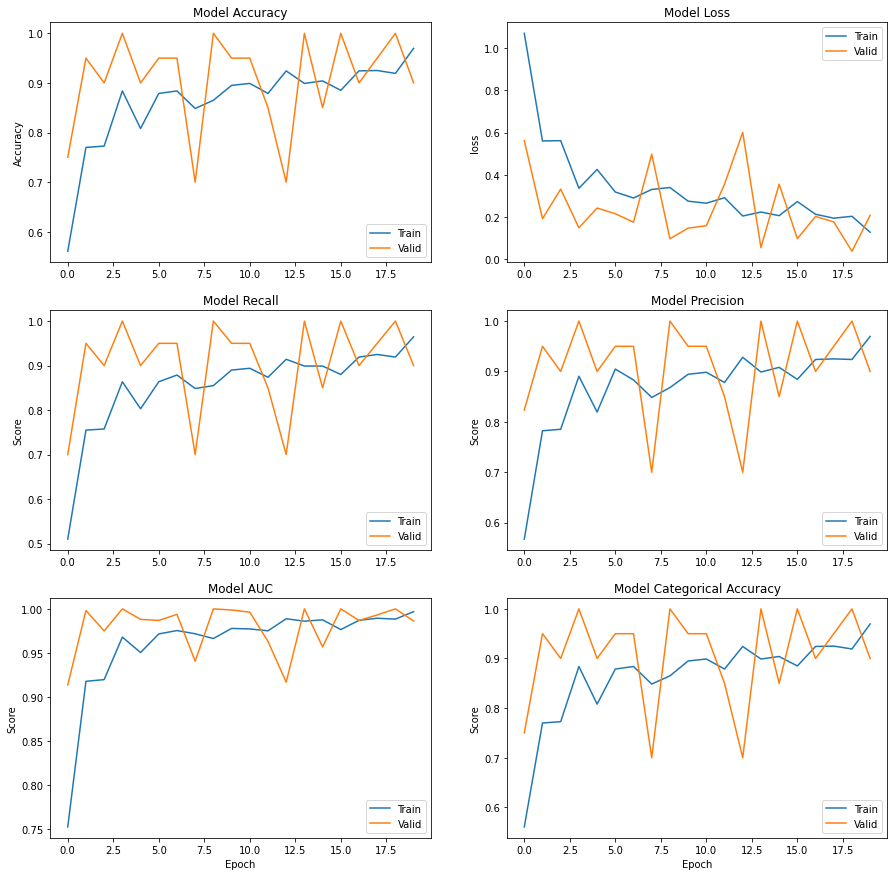

In [56]:
with open('/content/drive/MyDrive/basedata2/mobilenet_score.h5', 'rb') as score:
    fit_history = pickle.load(score)

plt.figure(1, figsize = (15,15)) 


plt.subplot(321)  
plt.plot(fit_history[1][1])  
plt.plot(fit_history[7][1])  
plt.title('Model Accuracy')  
plt.ylabel('Accuracy')
plt.legend(['Train', 'Valid']) 
    
plt.subplot(322)  
plt.plot(fit_history[0][1])  
plt.plot(fit_history[6][1])  
plt.title('Model Loss')  
plt.ylabel('loss')  
plt.legend(['Train', 'Valid'])  

plt.subplot(323)  
plt.plot(fit_history[5][1])
plt.plot(fit_history[11][1])  
plt.title('Model Recall')  
plt.ylabel('Score')   
plt.legend(['Train', 'Valid']) 

plt.subplot(324)  
plt.plot(fit_history[4][1])
plt.plot(fit_history[10][1])  
plt.title('Model Precision')  
plt.ylabel('Score')  
plt.legend(['Train', 'Valid']) 

plt.subplot(325)  
plt.plot(fit_history[2][1])
plt.plot(fit_history[8][1])  
plt.title('Model AUC')  
plt.ylabel('Score')  
plt.xlabel('Epoch')   
plt.legend(['Train', 'Valid']) 

plt.subplot(326)  
plt.plot(fit_history[3][1])
plt.plot(fit_history[9][1])  
plt.title('Model Categorical Accuracy')  
plt.ylabel('Score')  
plt.xlabel('Epoch')   
plt.legend(['Train', 'Valid']) 

plt.show()

Found 358 images belonging to 3 classes.
Found 90 images belonging to 3 classes.


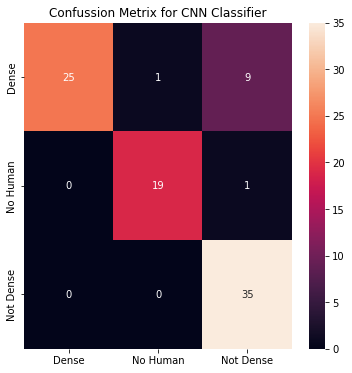

In [57]:
from sklearn.metrics import confusion_matrix
import seaborn as sn
import matplotlib.pyplot as plt
%matplotlib inline

classes = ['Dense', 'No Human', "Not Dense"]
_, valid_data = data_generator()
per = np.random.permutation(valid_data.n)
valid_data.index_array = per
cm = confusion_matrix(valid_data.classes[per], model.predict(valid_data).argmax(axis=1))
plt.figure(figsize = (6, 6))
plt.title("Confussion Metrix for CNN Classifier")
sn.heatmap(cm, annot=True, xticklabels=classes, yticklabels=classes)

In [58]:
from sklearn.metrics import classification_report
_, valid_data = data_generator()
per = np.random.permutation(valid_data.n)
valid_data.index_array = per
print(classification_report(valid_data.classes[per], model.predict(valid_data).argmax(axis=1), target_names=classes))

Found 358 images belonging to 3 classes.
Found 90 images belonging to 3 classes.
              precision    recall  f1-score   support

       Dense       1.00      0.71      0.83        35
    No Human       0.95      0.95      0.95        20
   Not Dense       0.78      1.00      0.88        35

    accuracy                           0.88        90
   macro avg       0.91      0.89      0.89        90
weighted avg       0.90      0.88      0.88        90

